In [1]:
import torch
import cv2
import numpy as np
import matplotlib.pylab as plt
from models.dino_segmentation import DINOv2Segmenter
from models.DINO_with_SAM import DINOwithSAM
from utils.commons import load
from utils.data import FoodRecognitionDataset
from torch.utils.data import DataLoader


In [2]:
model = DINOv2Segmenter(124)
load({
    "model": model
}, "checkpoints/dino_l_seg/latest.pt")

model = model.to(1)
model = model.eval()

Using cache found in /home/wayexists/.cache/torch/hub/facebookresearch_dinov2_main
xFormers not available
xFormers not available


Context has been loaded from checkpoints/dino_l_seg/latest.pt.


In [3]:
dino_with_sam = DINOwithSAM(model).to(1)
dino_with_sam.eval()

DINOwithSAM(
  (sam): Sam(
    (image_encoder): ImageEncoderViT(
      (patch_embed): PatchEmbed(
        (proj): Conv2d(3, 1280, kernel_size=(16, 16), stride=(16, 16))
      )
      (blocks): ModuleList(
        (0-31): 32 x Block(
          (norm1): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
          (attn): Attention(
            (qkv): Linear(in_features=1280, out_features=3840, bias=True)
            (proj): Linear(in_features=1280, out_features=1280, bias=True)
          )
          (norm2): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
          (mlp): MLPBlock(
            (lin1): Linear(in_features=1280, out_features=5120, bias=True)
            (lin2): Linear(in_features=5120, out_features=1280, bias=True)
            (act): GELU(approximate='none')
          )
        )
      )
      (neck): Sequential(
        (0): Conv2d(1280, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): LayerNorm2d()
        (2): Conv2d(256, 256, kernel_size=(3, 3

In [4]:
dataset = FoodRecognitionDataset("val")
len(dataset)

loading annotations into memory...
Done (t=0.04s)
creating index...
index created!


867

In [5]:
HEATMAP_THRESHOLD = 0.8
EXISTENCE_THRESHOLD = 0.85
COVERAGE_THRESHOLD = 0.7
DIFERENCE_THRESHOLD = 0.4

# HEATMAP_THRESHOLD = 0.75
# EXISTENCE_THRESHOLD = 0.85
# COVERAGE_THRESHOLD = 0.75
# COMPLEMENT_THRESHOLD = 0.35

In [12]:
@torch.no_grad()
def test(seed):
    torch.manual_seed(seed)
    dloader = DataLoader(dataset, shuffle=True)
    dloader_iter = iter(dloader)

    for i, data_item in enumerate(dloader_iter):
        print(i)
        image = data_item["image"].to(1)
        heatmap = data_item["heatmap"]
        N, _, H, W = image.size()
        
        res = dino_with_sam(
            image, 
            num_points=10,
            heatmap_threshold=HEATMAP_THRESHOLD,
            existence_threshold=EXISTENCE_THRESHOLD,
            coverage_ratio_threshold=COVERAGE_THRESHOLD,
            difference_ratio_threshold=DIFERENCE_THRESHOLD,
        )

        resulting_masks = res["resulting_masks"]
        existence_pred = res["exist_pred"]
        heatmap_pred = res["heatmap_pred"]

        image = image[0].cpu()
        image = image.permute(1, 2, 0)*dataset.PIXEL_STD + dataset.PIXEL_MEAN
        image = image.numpy().astype(np.uint8)
        
        resulting_masks = resulting_masks[0]
        heatmap = heatmap[0].cpu()
        heatmap_pred = heatmap_pred[0].cpu()
        existence_pred = existence_pred[0].cpu()
        existence_index = torch.arange(existence_pred.size(0))[existence_pred >= 0.85].cpu()

        # print("len of existence:", len(existence_index))
        if len(existence_index) == 0: continue

        print("Categories:", [dataset.new_cat_names[idx] for idx in existence_index.numpy().tolist()])
        
        heatmap = heatmap[existence_index]
        heatmap_pred = heatmap_pred[existence_index]

        print(existence_index)
        print(heatmap.shape, heatmap.min(), heatmap.max())
        print("Num of resulting mask:", len(resulting_masks))

        print("LABEL")

        fig, ax = plt.subplots(1, 2, figsize=(8, 4))
        ax[0].imshow(image)
        ax[0].axis("off")

        ax[1].imshow(image)
        ax[1].axis("off")

        heatmap = (heatmap > 0.5).float()
        heatmap = torch.cat([
            torch.zeros(1, H, W) + 0.5,
            heatmap
        ], dim=0).argmax(dim=0).numpy()

        ax[1].imshow(heatmap, alpha=(heatmap > 0).astype(np.float32))

        plt.tight_layout()
        plt.show()
        
        print("SAM Prediction")

        fig, ax = plt.subplots(1, 2, figsize=(8, 4))
        ax[0].imshow(image)
        ax[0].axis("off")

        ax[1].imshow(image)
        ax[1].axis("off")

        resulting_masks = np.stack(resulting_masks, axis=0)
        resulting_masks = (resulting_masks > 0.5).astype(np.float32)
        resulting_masks = np.concatenate([
            np.zeros((1, H, W)) + 0.5,
            resulting_masks
        ], axis=0).argmax(axis=0)

        ax[1].imshow(resulting_masks, alpha=(resulting_masks > 0).astype(np.float32))

        plt.tight_layout()
        plt.show()

        if i >= 5:
            break

0
Categories: ['coffee']
tensor([30])
torch.Size([1, 448, 448]) tensor(0.0500) tensor(0.9000)
Num of resulting mask: 1
LABEL


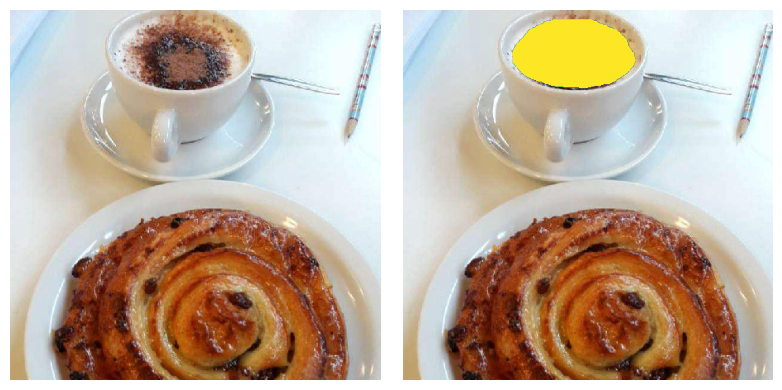

SAM Prediction


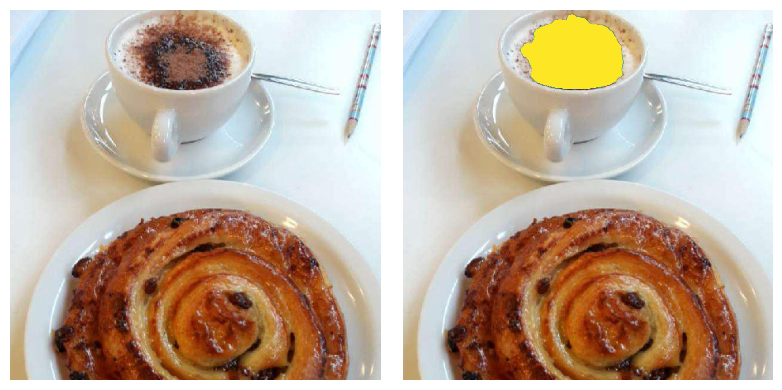

1
Categories: ['water']
tensor([119])
torch.Size([1, 448, 448]) tensor(0.0500) tensor(0.9000)
Num of resulting mask: 1
LABEL


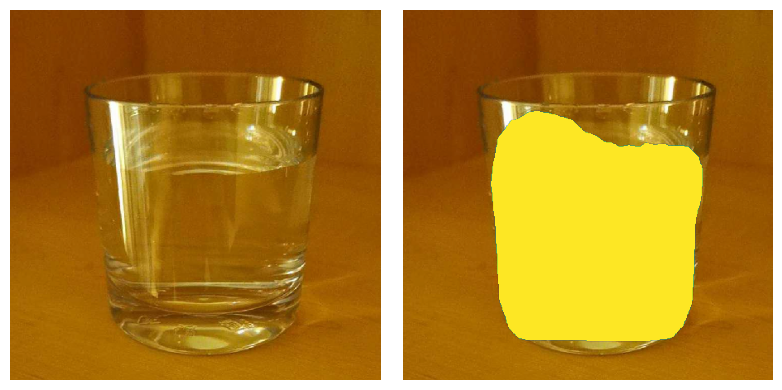

SAM Prediction


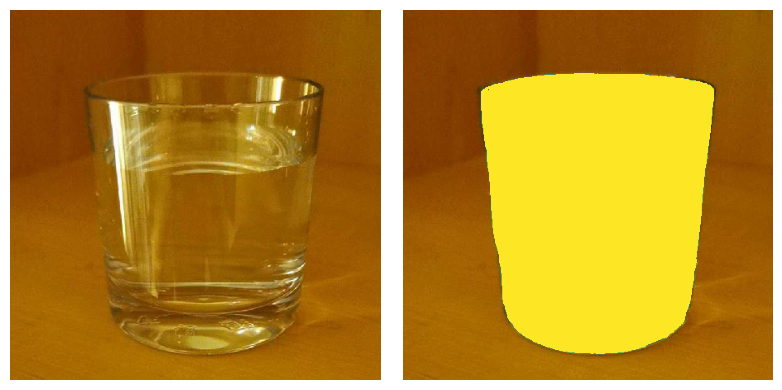

2
Categories: ['rice', 'shrimp']
tensor([101, 106])
torch.Size([2, 448, 448]) tensor(0.) tensor(0.9000)
Num of resulting mask: 2
LABEL


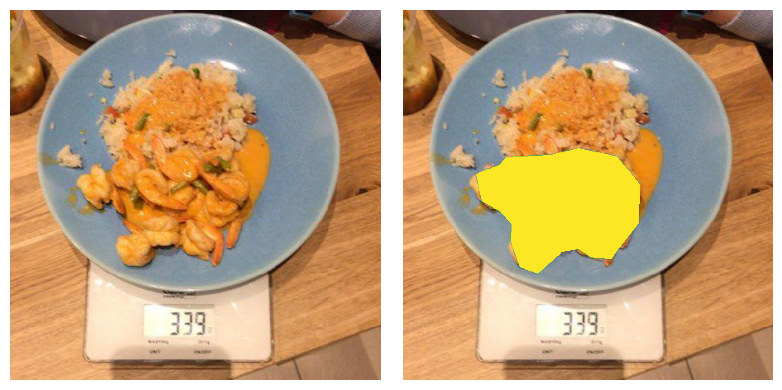

SAM Prediction


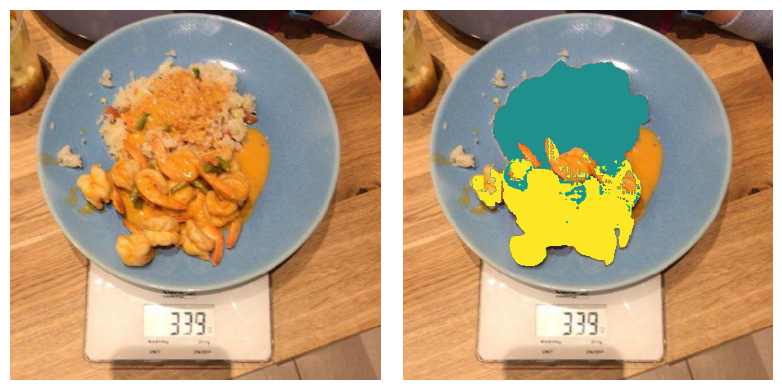

3
Categories: ['carrot', 'onion', 'vegetables']
tensor([ 18,  76, 118])
torch.Size([3, 448, 448]) tensor(0.) tensor(0.9000)
Num of resulting mask: 3
LABEL


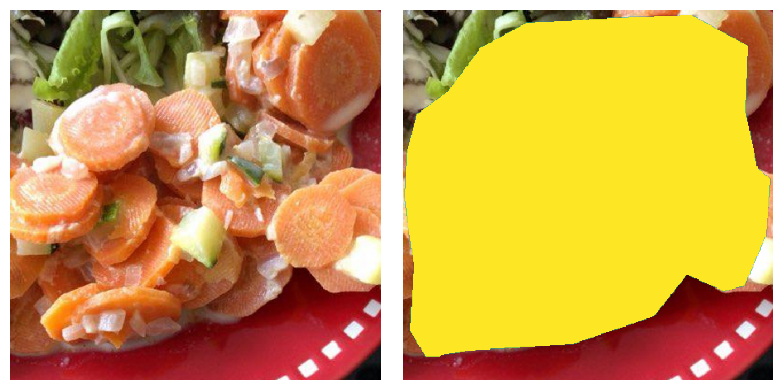

SAM Prediction


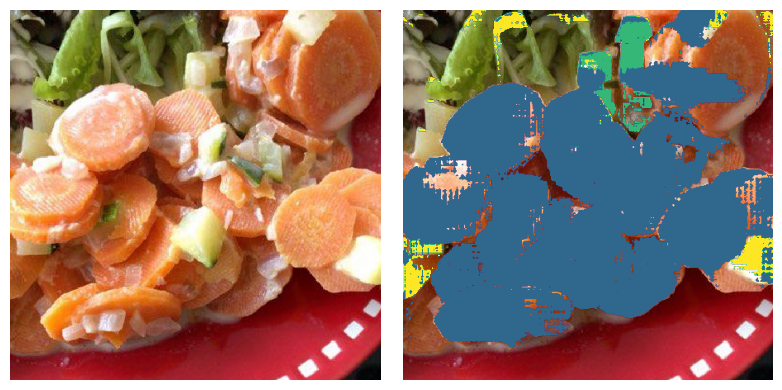

4
Categories: ['french fries']
tensor([53])
torch.Size([1, 448, 448]) tensor(0.0500) tensor(0.9000)
Num of resulting mask: 1
LABEL


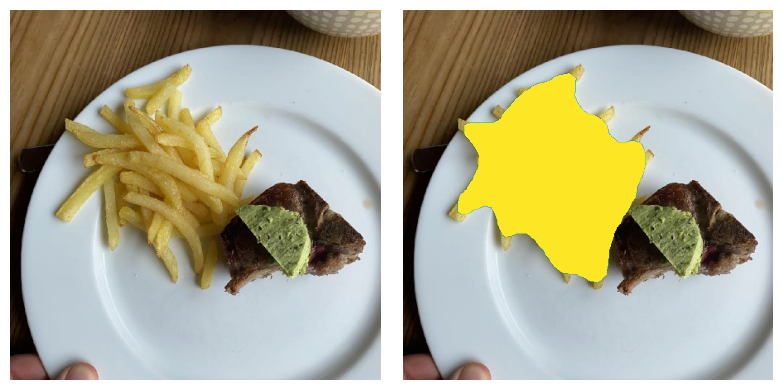

SAM Prediction


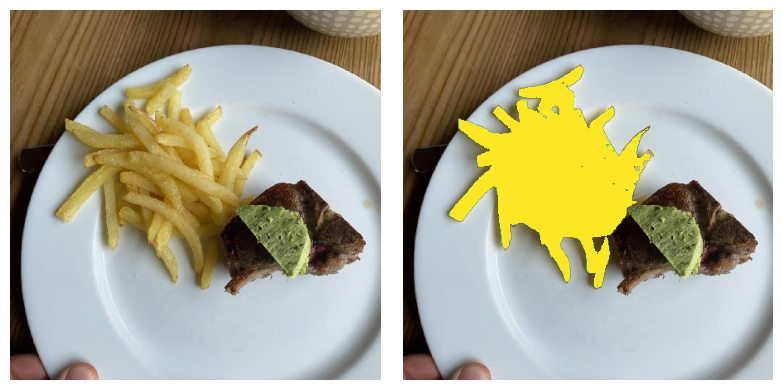

5
Categories: ['bread']
tensor([14])
torch.Size([1, 448, 448]) tensor(0.0500) tensor(0.9000)
Num of resulting mask: 1
LABEL


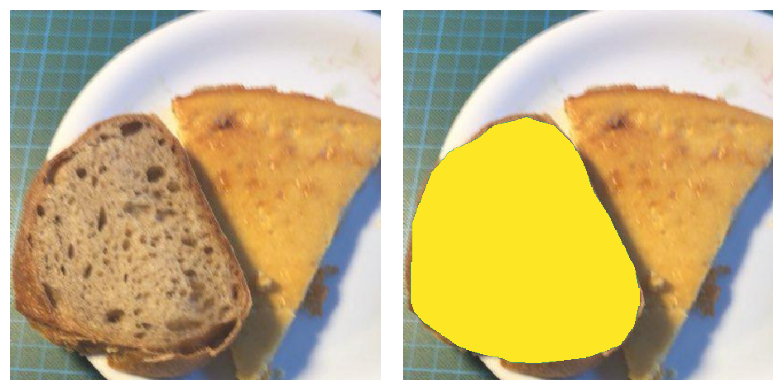

SAM Prediction


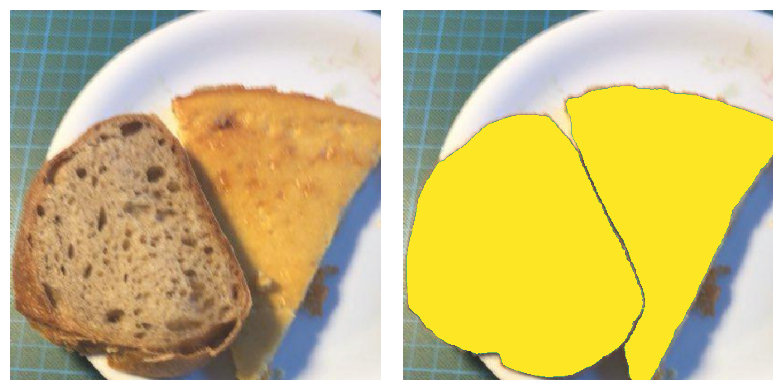

In [13]:
test(910)

0
Categories: ['falafel']
tensor([48])
torch.Size([1, 448, 448]) tensor(0.0500) tensor(0.9000)
Num of resulting mask: 1
LABEL


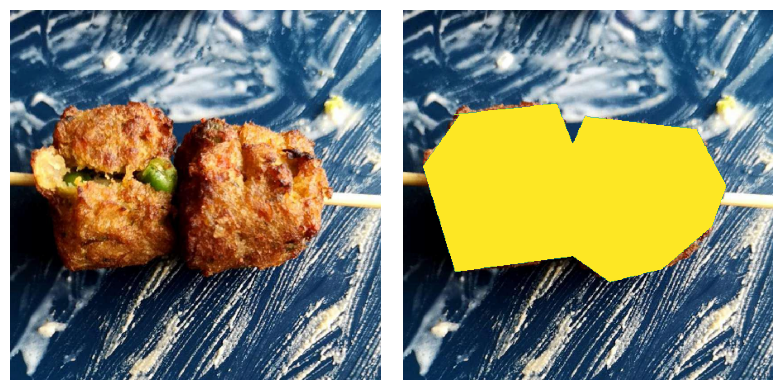

SAM Prediction


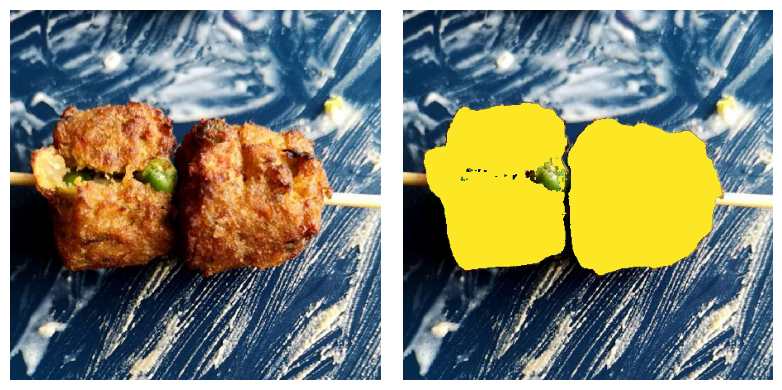

1
2
Categories: ['bread', 'shrimp', 'vegetables']
tensor([ 14, 106, 118])
torch.Size([3, 448, 448]) tensor(0.0500) tensor(0.9000)
Num of resulting mask: 3
LABEL


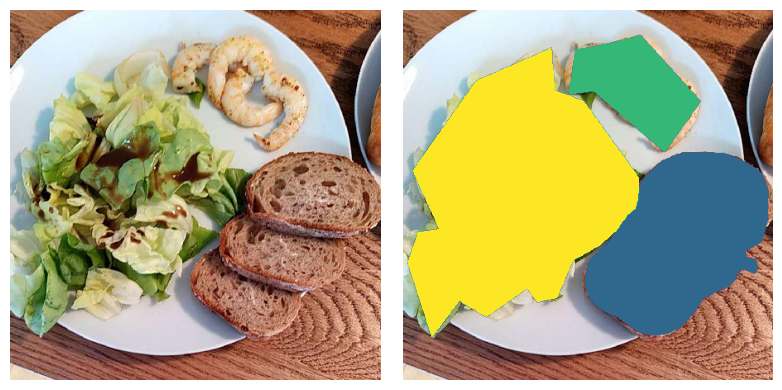

SAM Prediction


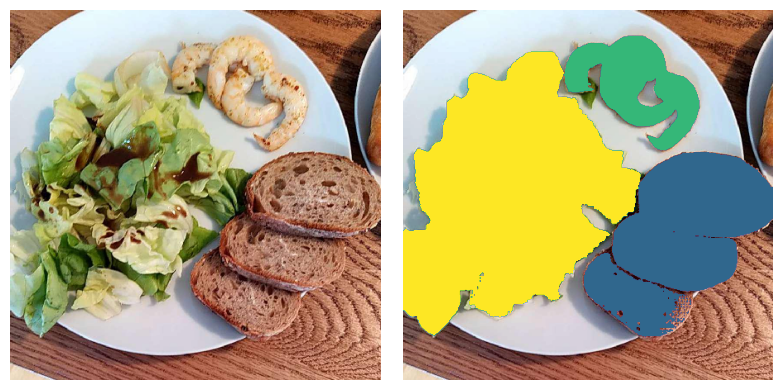

3
Categories: ['egg']
tensor([45])
torch.Size([1, 448, 448]) tensor(0.0500) tensor(0.9000)
Num of resulting mask: 1
LABEL


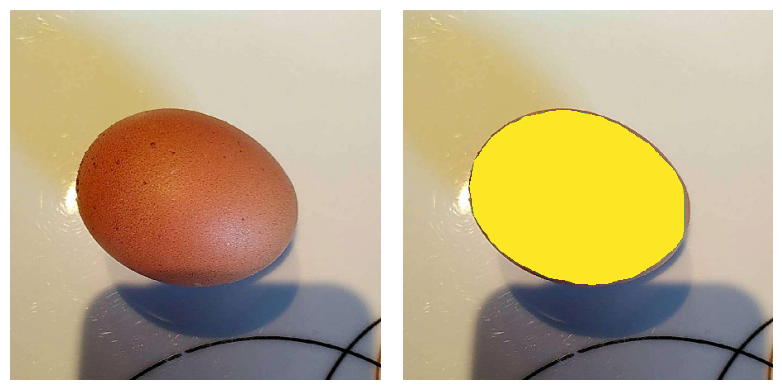

SAM Prediction


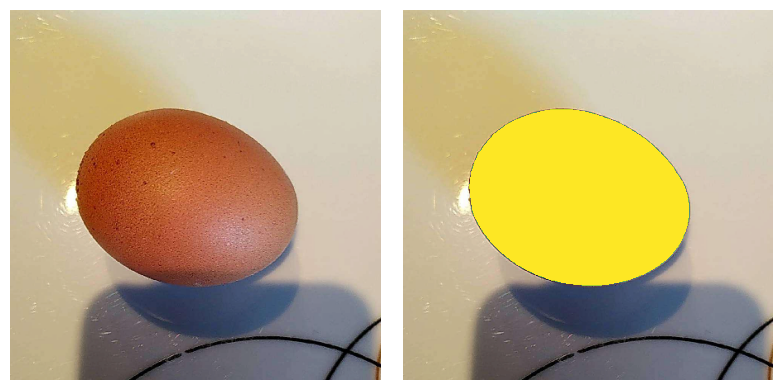

4
Categories: ['beef', 'rice', 'vegetables']
tensor([  9, 101, 118])
torch.Size([3, 448, 448]) tensor(0.) tensor(0.9000)
Num of resulting mask: 3
LABEL


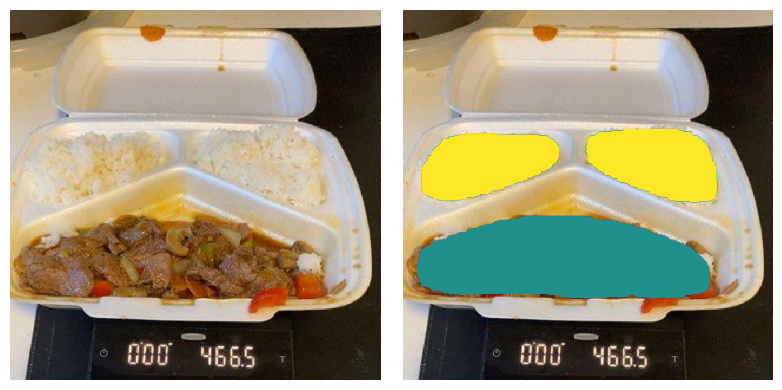

SAM Prediction


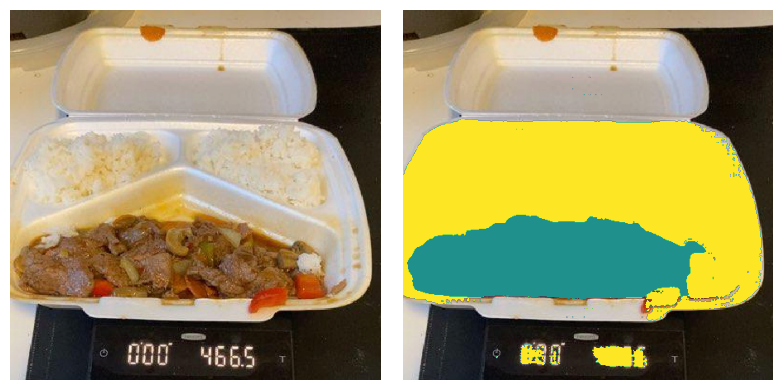

5
6
Categories: ['water']
tensor([119])
torch.Size([1, 448, 448]) tensor(0.0500) tensor(0.9000)
Num of resulting mask: 1
LABEL


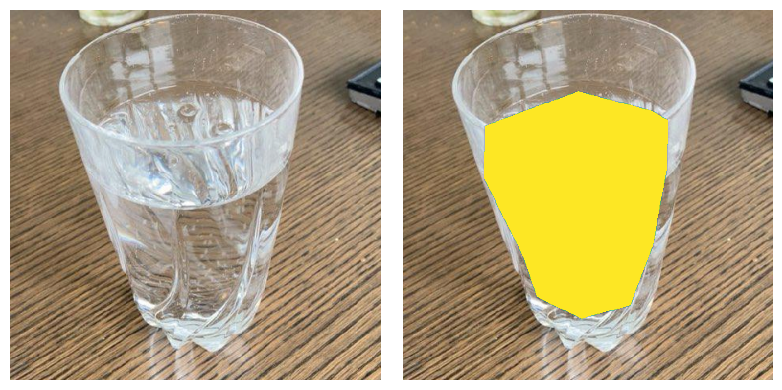

SAM Prediction


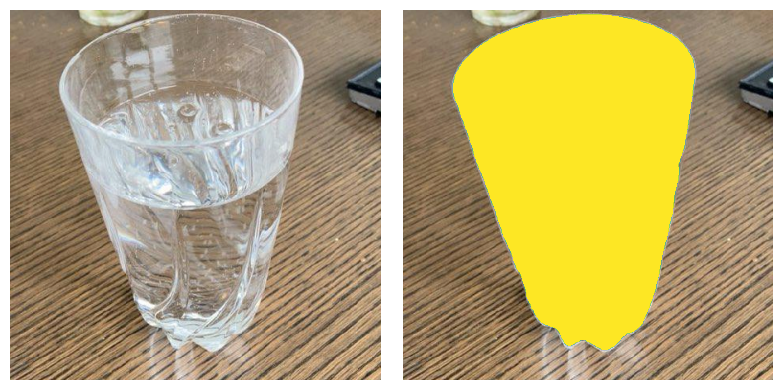

In [14]:
test(1920)

In [15]:
@torch.no_grad()
def test(seed):
    torch.manual_seed(seed)
    dloader = DataLoader(dataset, shuffle=True)
    dloader_iter = iter(dloader)

    for i, data_item in enumerate(dloader_iter):
        image = data_item["image"].to(1)
        heatmap = data_item["heatmap"]
        N, _, H, W = image.size()
        
        res = dino_with_sam(
            image, 
            num_points=10,
            heatmap_threshold=HEATMAP_THRESHOLD,
            existence_threshold=EXISTENCE_THRESHOLD,
            coverage_ratio_threshold=COVERAGE_THRESHOLD,
            difference_ratio_threshold=DIFERENCE_THRESHOLD,
        )

        resulting_masks = res["resulting_masks"]
        existence_pred = res["exist_pred"]
        heatmap_pred = res["heatmap_pred"]

        image = image[0].cpu()
        image = image.permute(1, 2, 0)*dataset.PIXEL_STD + dataset.PIXEL_MEAN
        image = image.numpy().astype(np.uint8)
        
        resulting_masks = resulting_masks[0]
        heatmap = heatmap[0].cpu()
        heatmap_pred = heatmap_pred[0].cpu()
        existence_pred = existence_pred[0].cpu()
        existence_index = torch.arange(existence_pred.size(0))[existence_pred >= 0.85].cpu()
        
        # print("len of existence:", len(existence_index))
        if len(existence_index) == 0: continue
        
        heatmap = heatmap[existence_index]
        heatmap_pred = heatmap_pred[existence_index]

        print(existence_index)
        print(heatmap.shape, heatmap.min(), heatmap.max())
        print("Num of resulting mask:", len(resulting_masks))

        print("LABEL")

        fig, ax = plt.subplots(1, heatmap.shape[0] + 1, figsize=(4*(heatmap.shape[0] + 1), 4))
        ax[0].imshow(image)
        ax[0].axis("off")
        for j in range(len(existence_index)):
            heatmap_j = heatmap[j][:, :, None].repeat(1, 1, 4)
            heatmap_j[..., 2] = 0.5*heatmap_j[..., 2]
            heatmap_j = heatmap_j.numpy()

            ax[j + 1].set_title(dataset.new_cat_names[int(existence_index[j])])
            ax[j + 1].imshow(image)
            ax[j + 1].imshow(heatmap_j)
            # ax[j + 1].axis("off")

        plt.tight_layout()
        plt.show()
        
        print("DINO v2 Heatmap")

        fig, ax = plt.subplots(1, heatmap.shape[0] + 1, figsize=(4*(heatmap.shape[0] + 1), 4))
        ax[0].imshow(image)
        ax[0].axis("off")
        for j in range(len(existence_index)):
            heatmap_pred_j = heatmap_pred[j][:, :, None].repeat(1, 1, 4)
            heatmap_pred_j = (heatmap_pred_j > HEATMAP_THRESHOLD).float()
            # heatmap_pred_j[heatmap_pred_j < HEATMAP_THRESHOLD] = 0
            heatmap_pred_j[..., 2] = 0.5*heatmap_pred_j[..., 2]
            heatmap_pred_j = heatmap_pred_j.numpy()

            ax[j + 1].set_title(dataset.new_cat_names[int(existence_index[j])])
            ax[j + 1].imshow(image)
            ax[j + 1].imshow(heatmap_pred_j)
            # ax[j + 1].axis("off")

        plt.tight_layout()
        plt.show()
        
        print("DINO v2 distance transofrm")

        fig, ax = plt.subplots(1, heatmap.shape[0] + 1, figsize=(4*(heatmap.shape[0] + 1), 4))
        ax[0].imshow(image)
        ax[0].axis("off")
        for j in range(len(existence_index)):
            heatmap_pred_j = heatmap_pred[j].numpy()
            heatmap_pred_j = (heatmap_pred_j > HEATMAP_THRESHOLD).astype(np.uint8) * 255
            heatmap_pred_j = cv2.distanceTransform(heatmap_pred_j, cv2.DIST_L2, 3)
            heatmap_pred_j = heatmap_pred_j.astype(np.float32)
            heatmap_pred_j = heatmap_pred_j / heatmap_pred_j.max()
            
            heatmap_pred_j = np.tile(heatmap_pred_j[:, :, None], [1, 1, 4])
            heatmap_pred_j[..., 2] = 0.5*heatmap_pred_j[..., 2]

            ax[j + 1].set_title(dataset.new_cat_names[int(existence_index[j])])
            ax[j + 1].imshow(image)
            ax[j + 1].imshow(heatmap_pred_j)
            # ax[j + 1].axis("off")

        plt.tight_layout()
        plt.show()
        
        print("SAM Prediction")

        fig, ax = plt.subplots(1, heatmap.shape[0] + 1, figsize=(4*(heatmap.shape[0] + 1), 4))
        ax[0].imshow(image)
        ax[0].axis("off")
        for j in range(len(existence_index)):
            pred_j = np.tile(resulting_masks[j][:, :, None], [1, 1, 4])
            pred_j[..., 2] = 0.5*pred_j[..., 2]

            ax[j + 1].set_title(dataset.new_cat_names[int(existence_index[j])])
            ax[j + 1].imshow(image)
            ax[j + 1].imshow(pred_j)
            # ax[j + 1].axis("off")

        plt.tight_layout()
        plt.show()

        if i >= 5:
            break

tensor([30])
torch.Size([1, 448, 448]) tensor(0.0500) tensor(0.9000)
Num of resulting mask: 1
LABEL


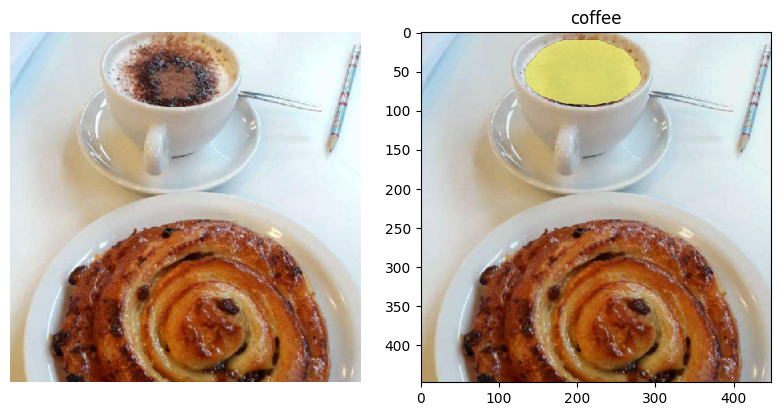

DINO v2 Heatmap


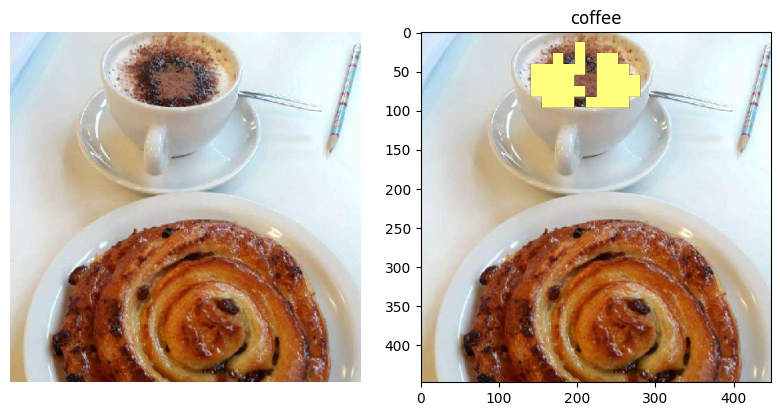

DINO v2 distance transofrm


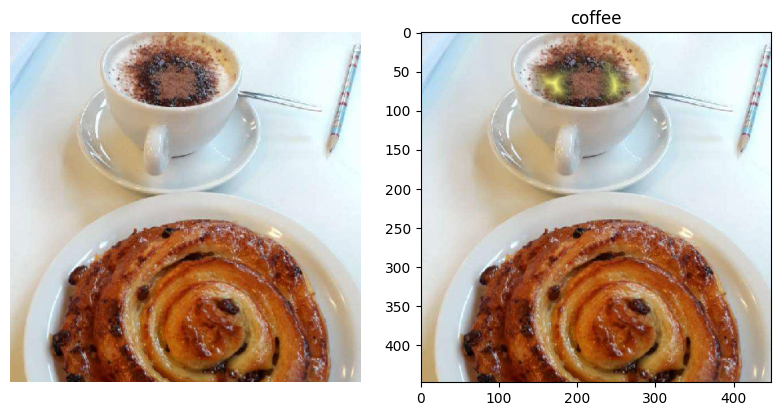

SAM Prediction


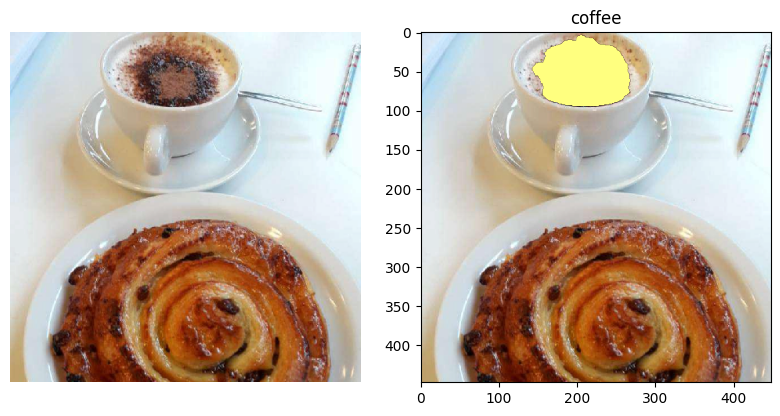

tensor([119])
torch.Size([1, 448, 448]) tensor(0.0500) tensor(0.9000)
Num of resulting mask: 1
LABEL


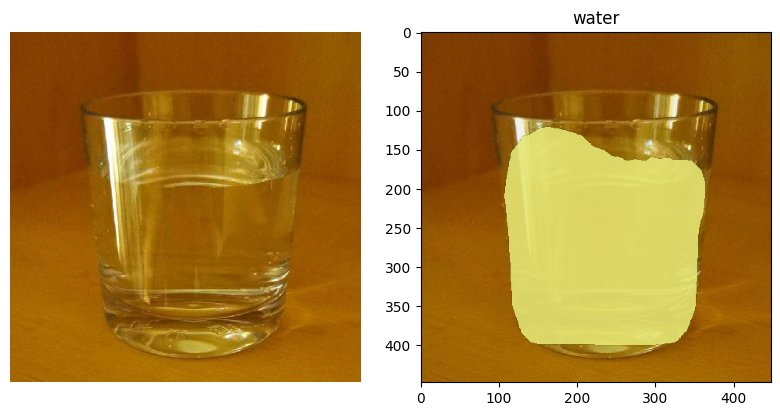

DINO v2 Heatmap


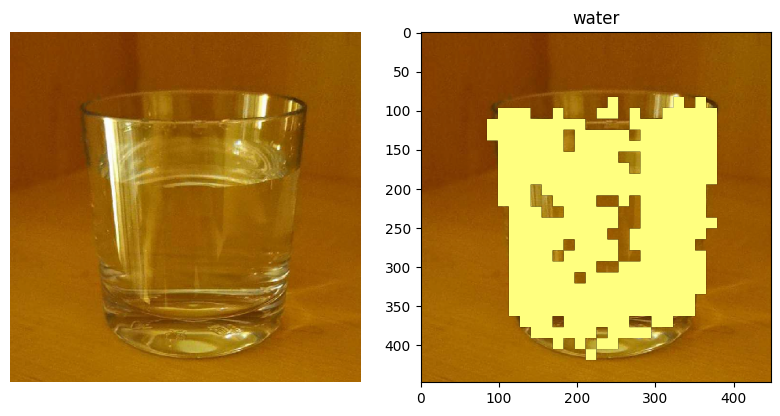

DINO v2 distance transofrm


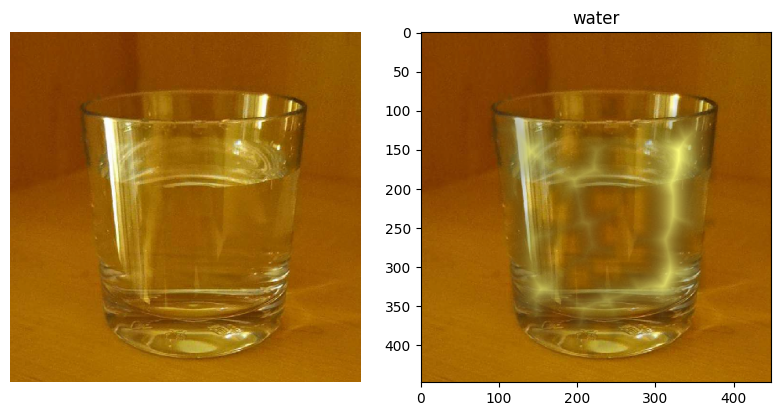

SAM Prediction


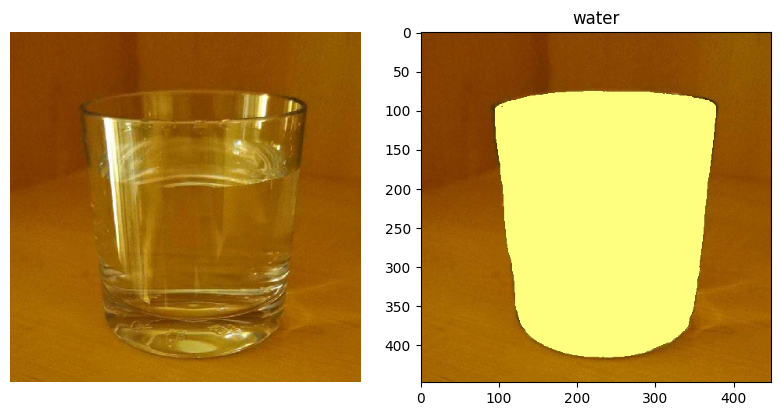

tensor([101, 106])
torch.Size([2, 448, 448]) tensor(0.) tensor(0.9000)
Num of resulting mask: 2
LABEL


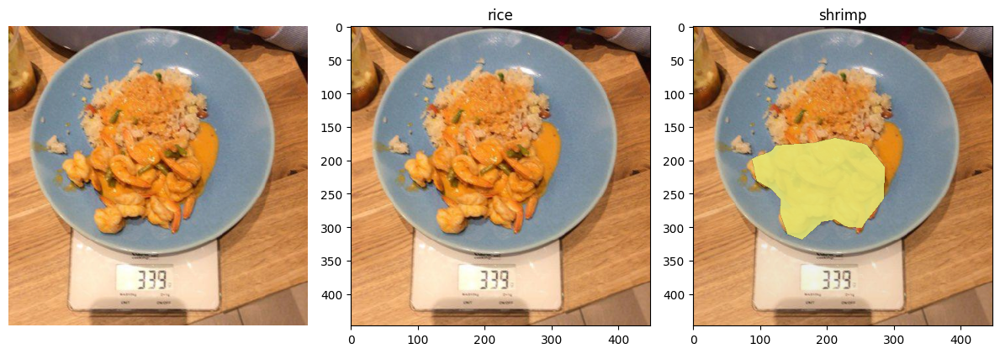

DINO v2 Heatmap


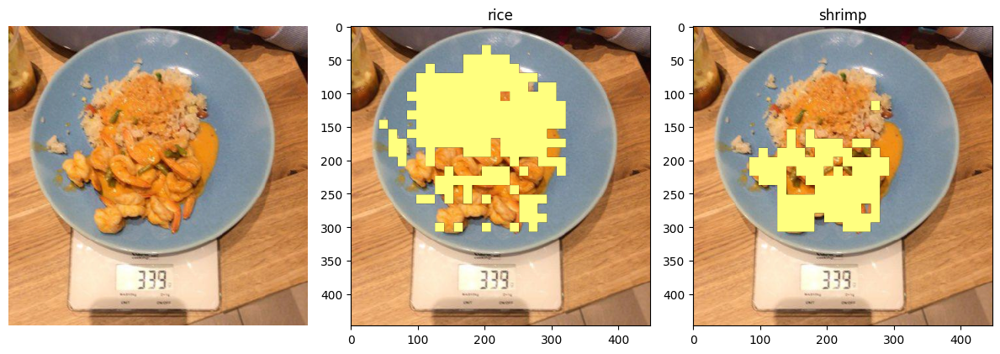

DINO v2 distance transofrm


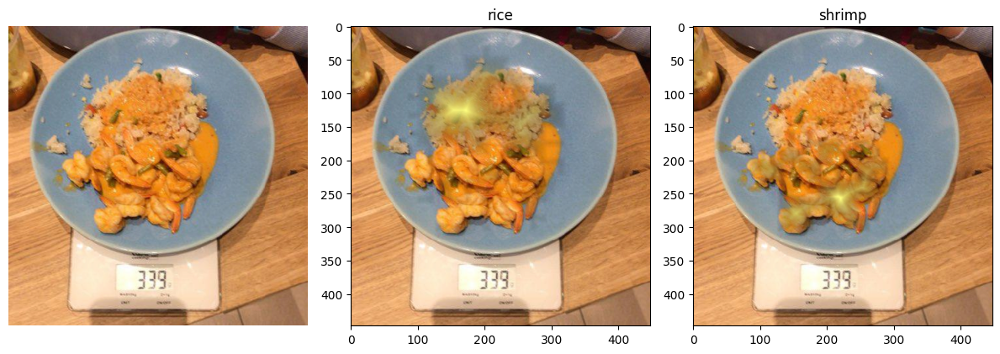

SAM Prediction


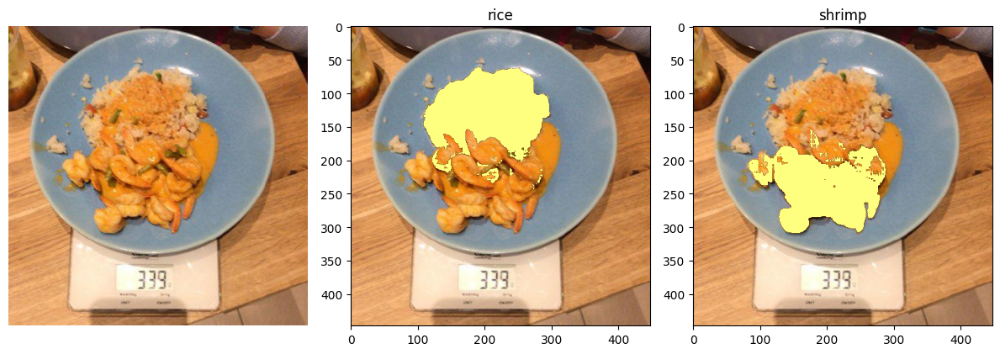

tensor([ 18,  76, 118])
torch.Size([3, 448, 448]) tensor(0.) tensor(0.9000)
Num of resulting mask: 3
LABEL


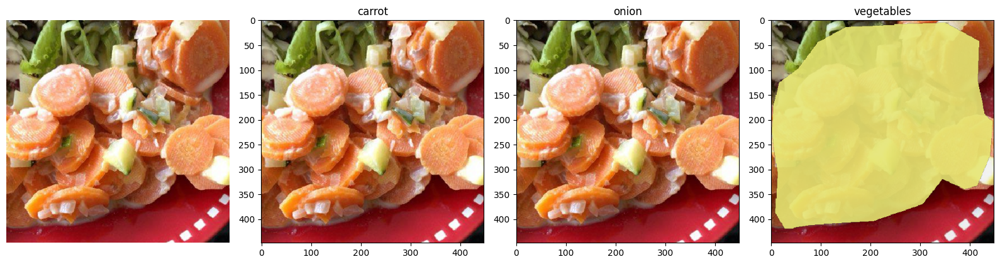

DINO v2 Heatmap


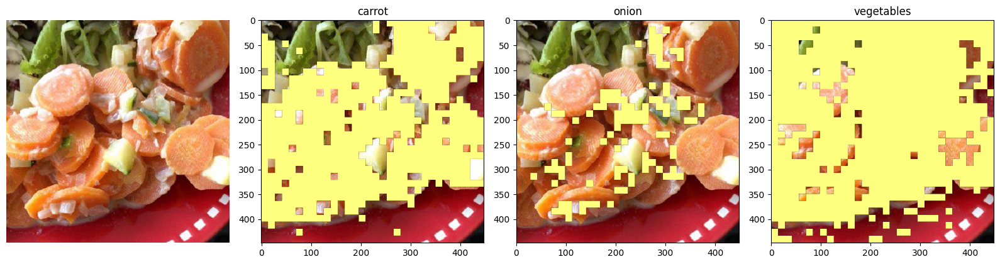

DINO v2 distance transofrm


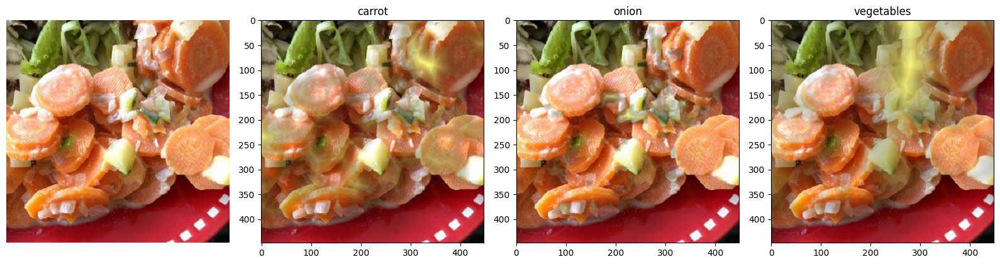

SAM Prediction


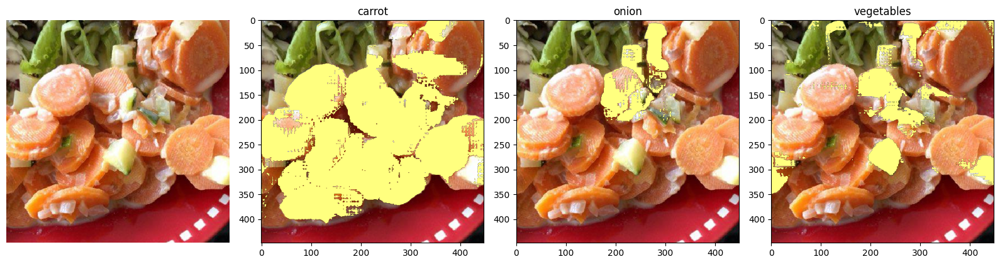

tensor([53])
torch.Size([1, 448, 448]) tensor(0.0500) tensor(0.9000)
Num of resulting mask: 1
LABEL


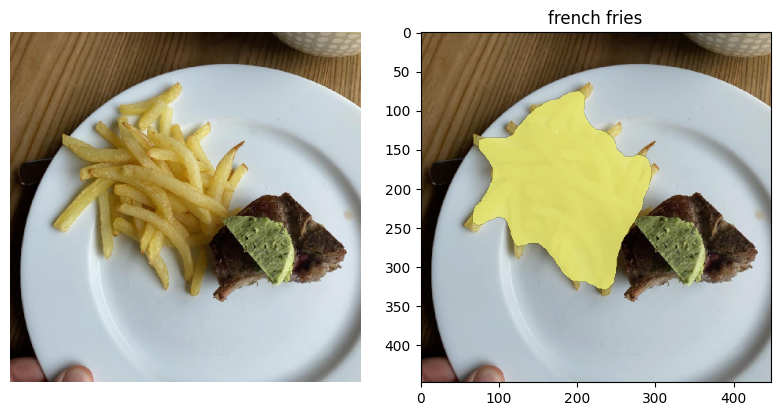

DINO v2 Heatmap


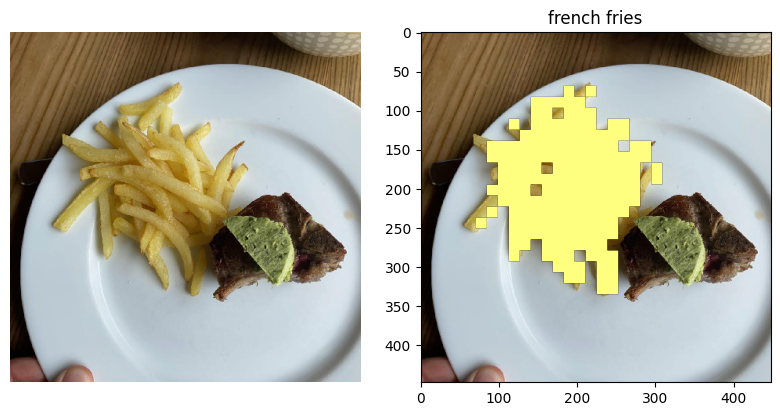

DINO v2 distance transofrm


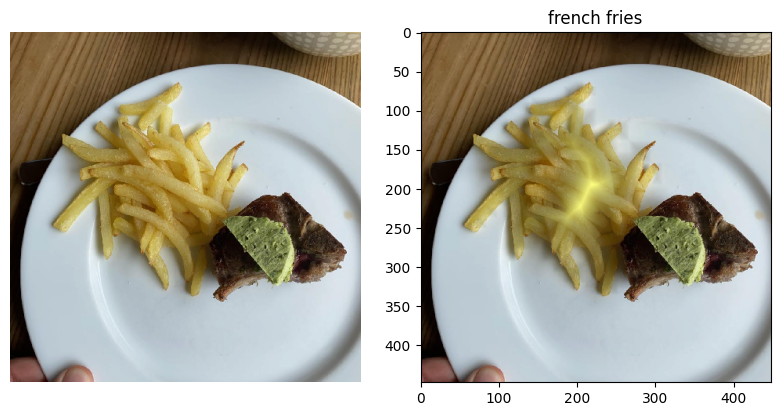

SAM Prediction


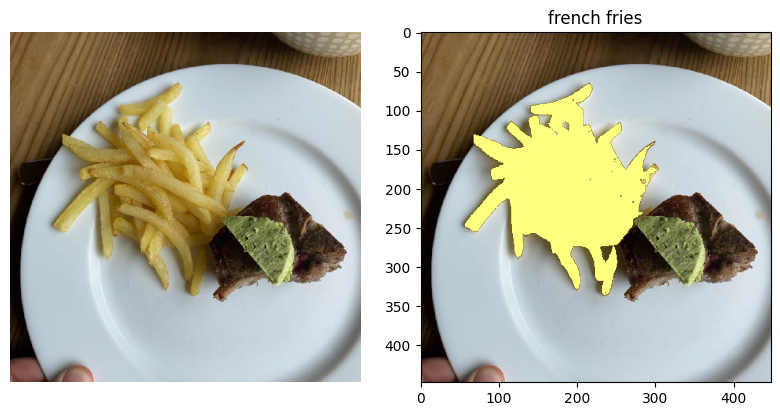

tensor([14])
torch.Size([1, 448, 448]) tensor(0.0500) tensor(0.9000)
Num of resulting mask: 1
LABEL


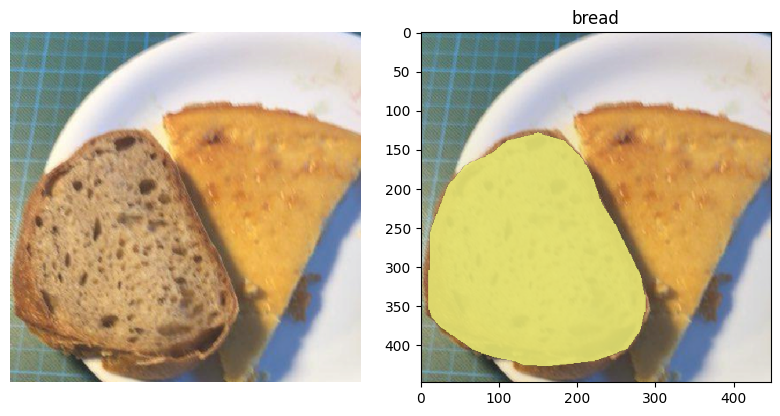

DINO v2 Heatmap


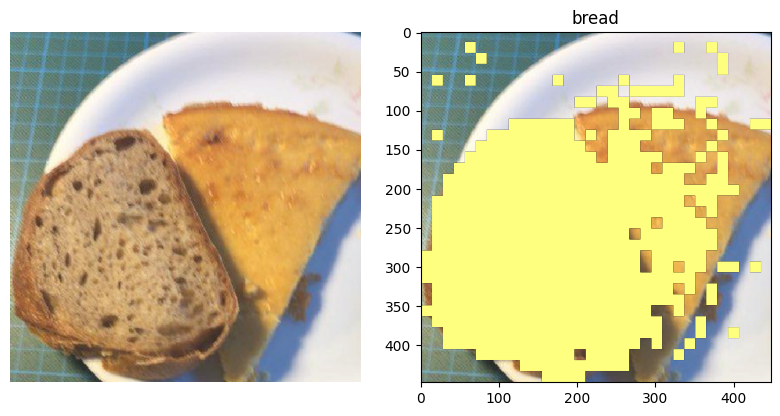

DINO v2 distance transofrm


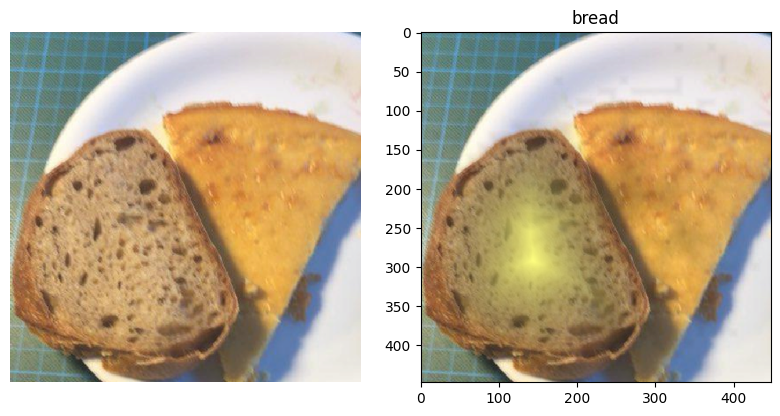

SAM Prediction


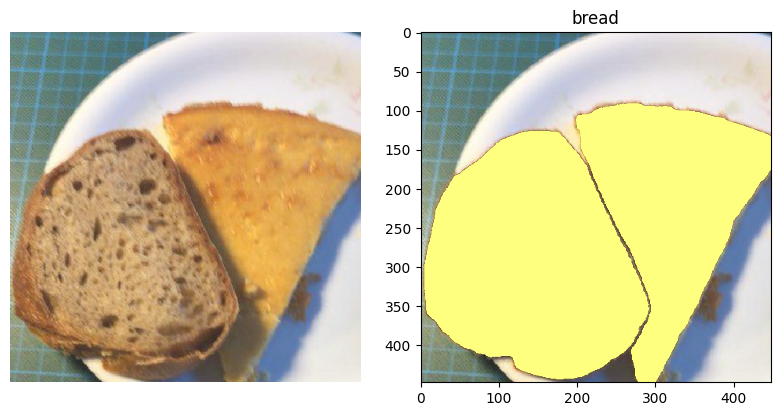

In [16]:
test(910)

tensor([56])
torch.Size([1, 448, 448]) tensor(0.0500) tensor(0.9000)
Num of resulting mask: 1
LABEL


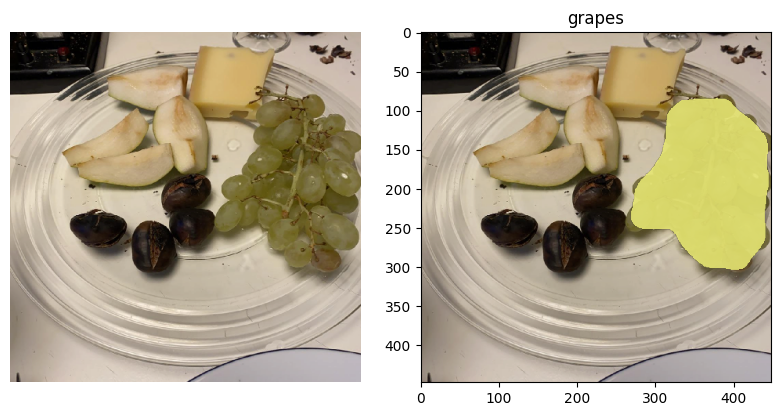

DINO v2 Heatmap


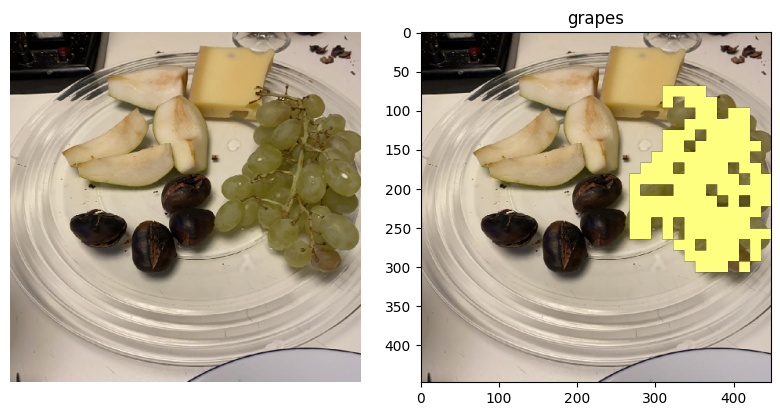

DINO v2 distance transofrm


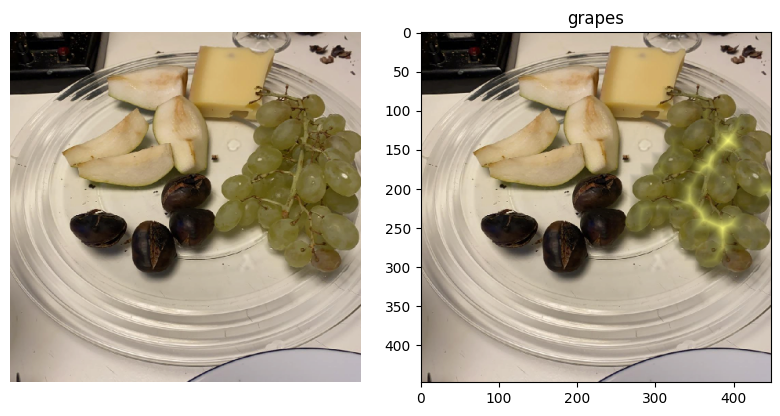

SAM Prediction


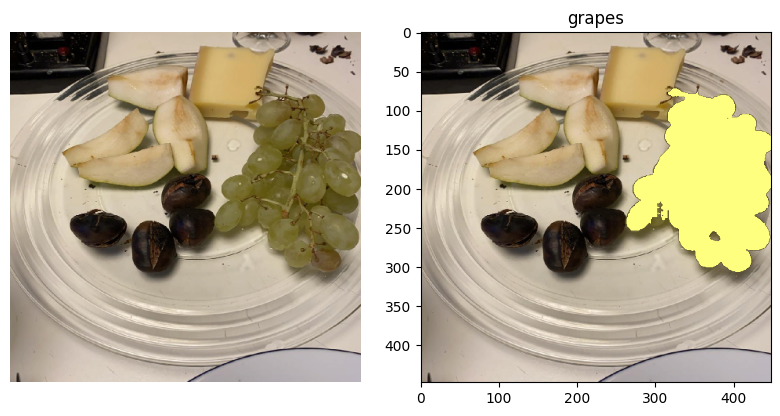

tensor([14, 16])
torch.Size([2, 448, 448]) tensor(0.) tensor(0.9000)
Num of resulting mask: 2
LABEL


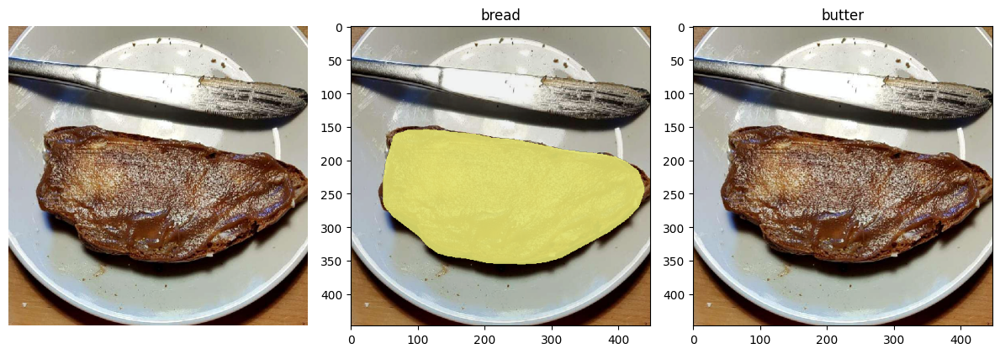

DINO v2 Heatmap


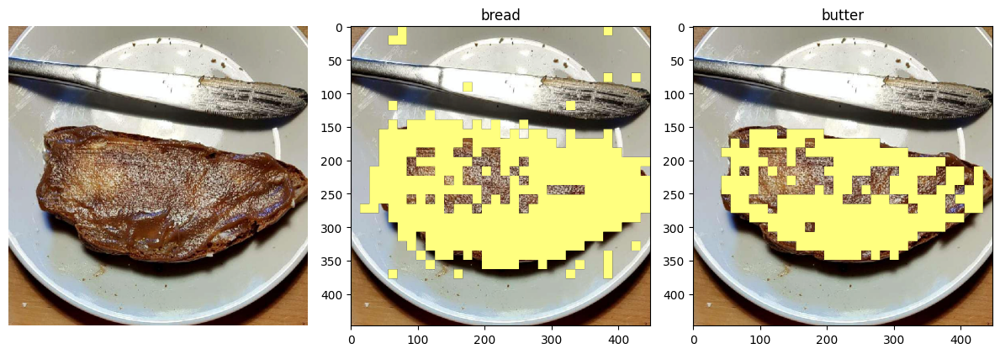

DINO v2 distance transofrm


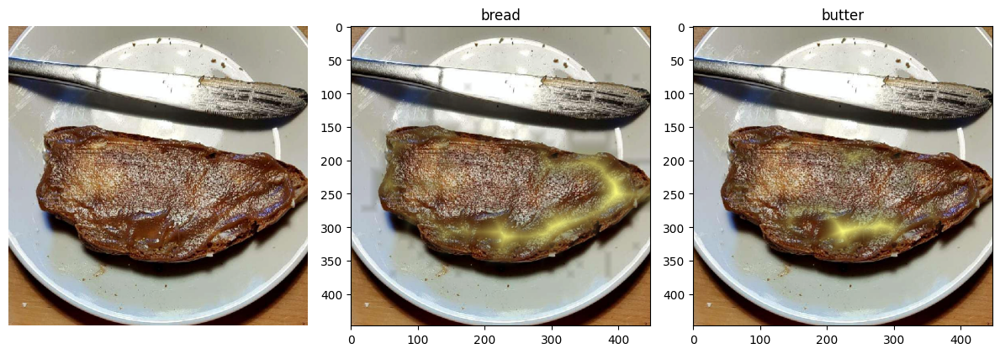

SAM Prediction


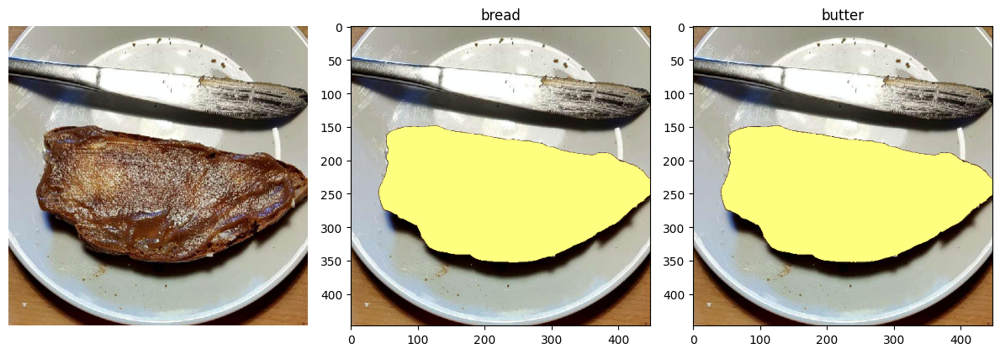

tensor([ 19, 108])
torch.Size([2, 448, 448]) tensor(0.0500) tensor(0.9000)
Num of resulting mask: 2
LABEL


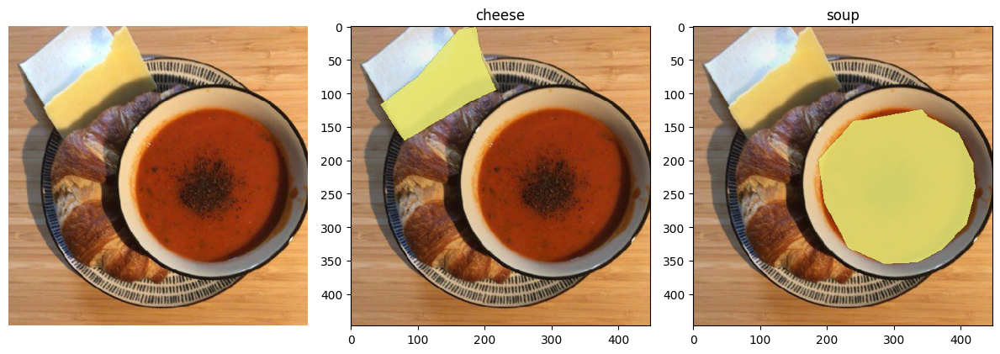

DINO v2 Heatmap


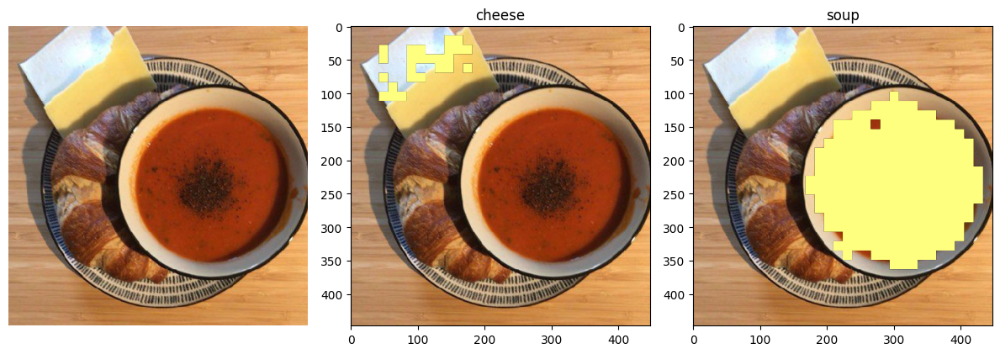

DINO v2 distance transofrm


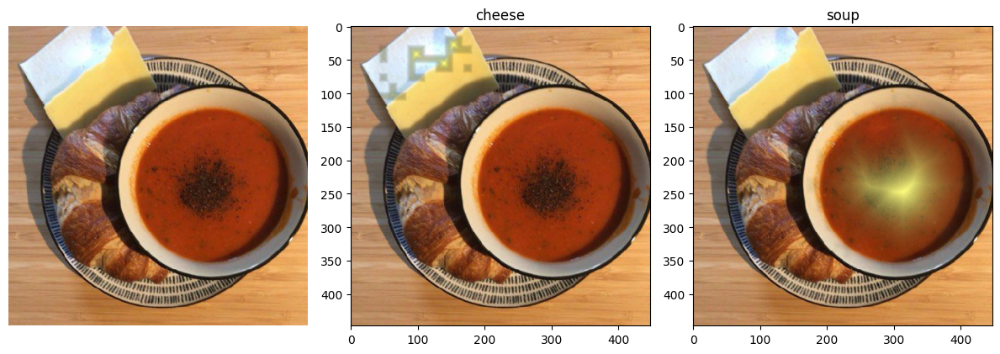

SAM Prediction


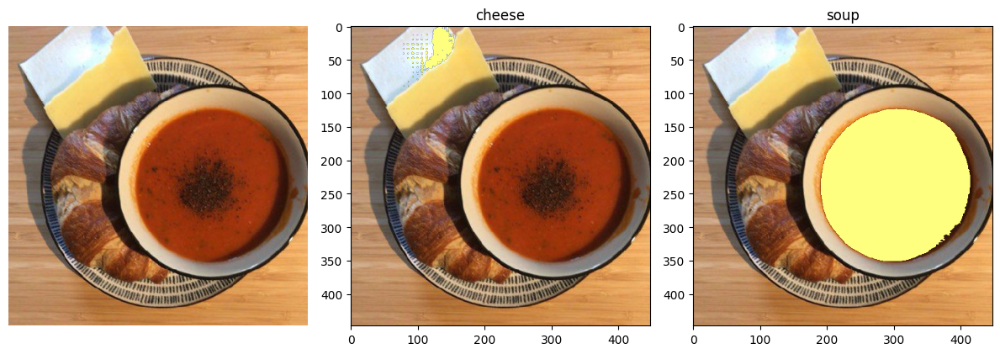

tensor([65, 67, 77])
torch.Size([3, 448, 448]) tensor(0.) tensor(0.9000)
Num of resulting mask: 3
LABEL


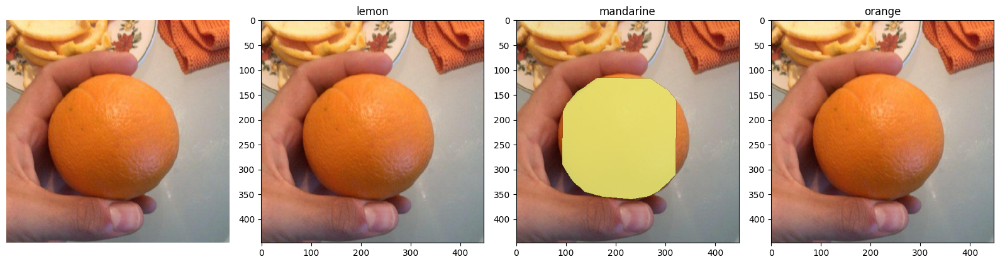

DINO v2 Heatmap


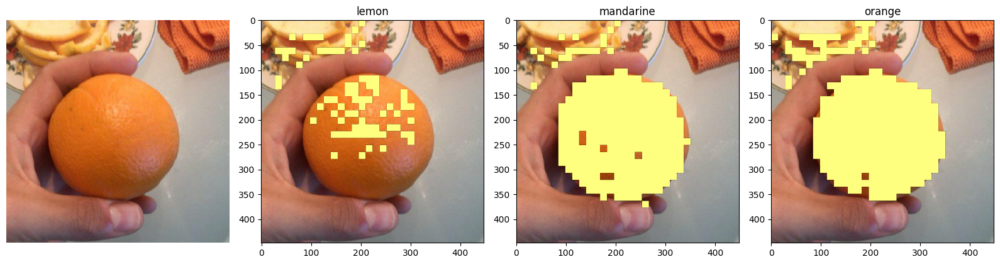

DINO v2 distance transofrm


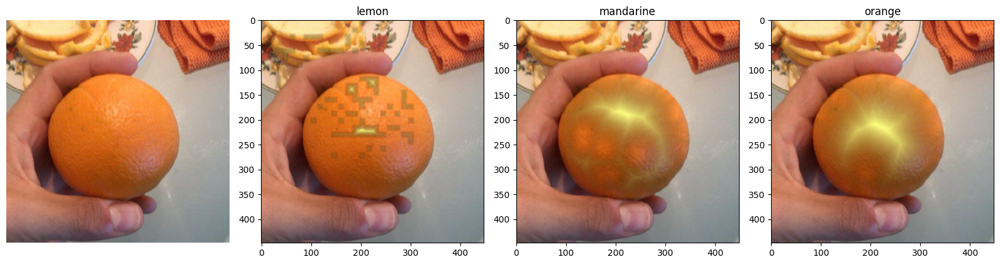

SAM Prediction


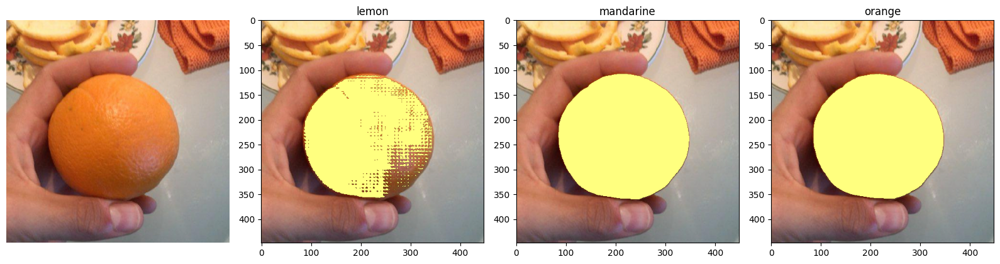

tensor([ 19,  71, 114])
torch.Size([3, 448, 448]) tensor(0.) tensor(0.)
Num of resulting mask: 3
LABEL


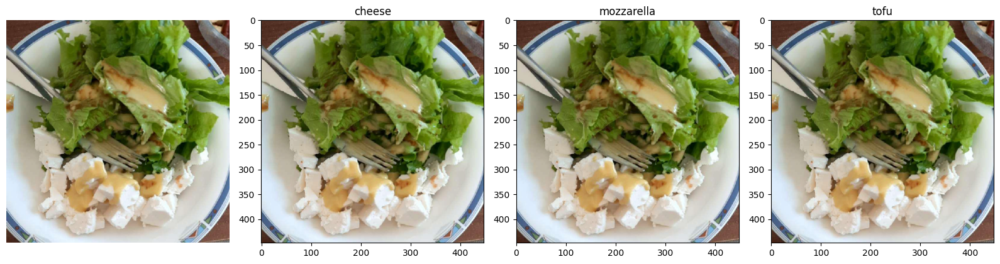

DINO v2 Heatmap


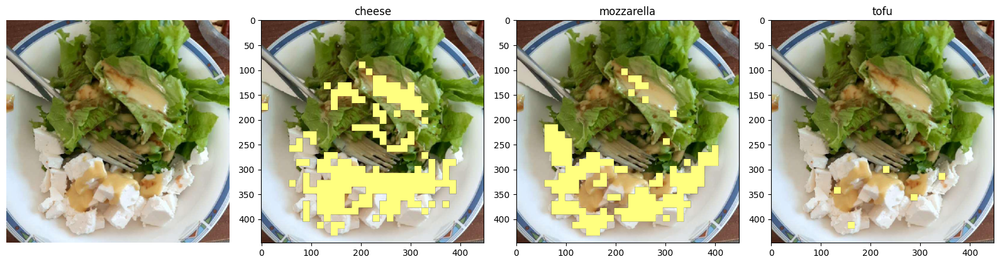

DINO v2 distance transofrm


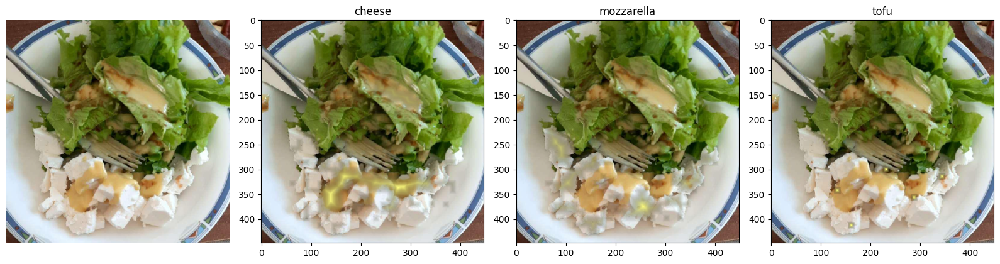

SAM Prediction


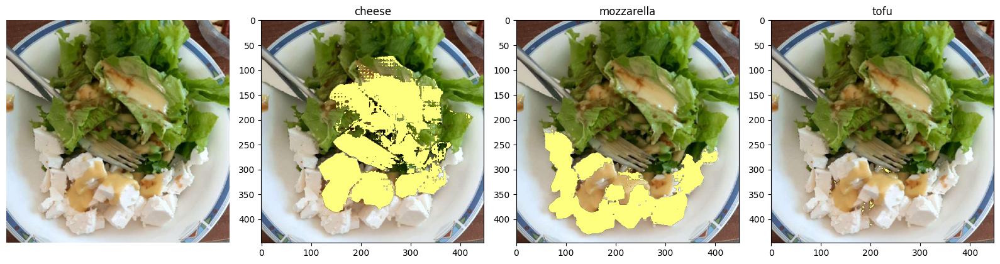

tensor([14])
torch.Size([1, 448, 448]) tensor(0.0500) tensor(0.9000)
Num of resulting mask: 1
LABEL


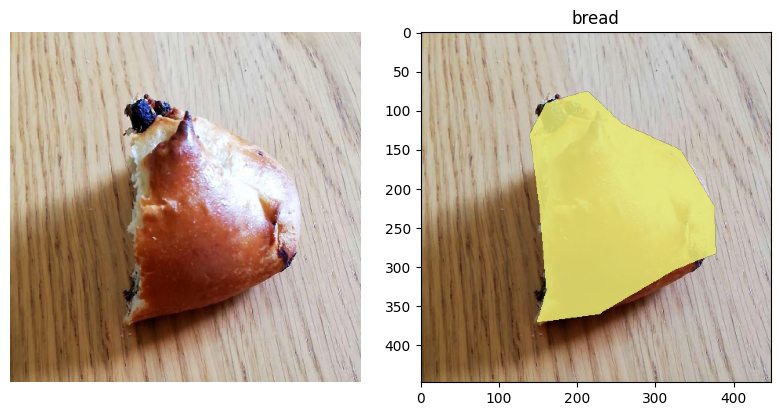

DINO v2 Heatmap


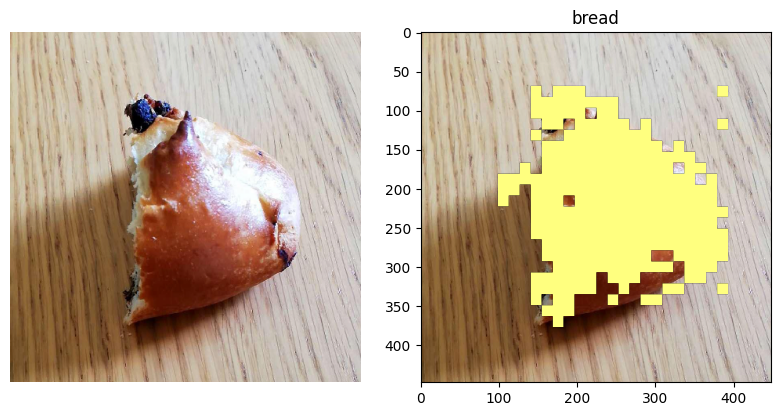

DINO v2 distance transofrm


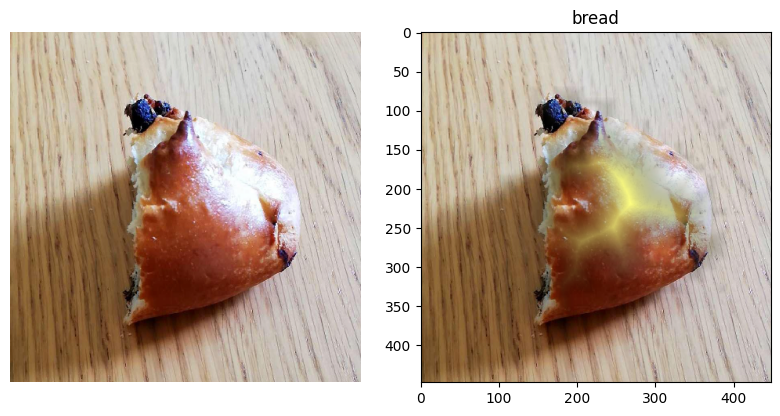

SAM Prediction


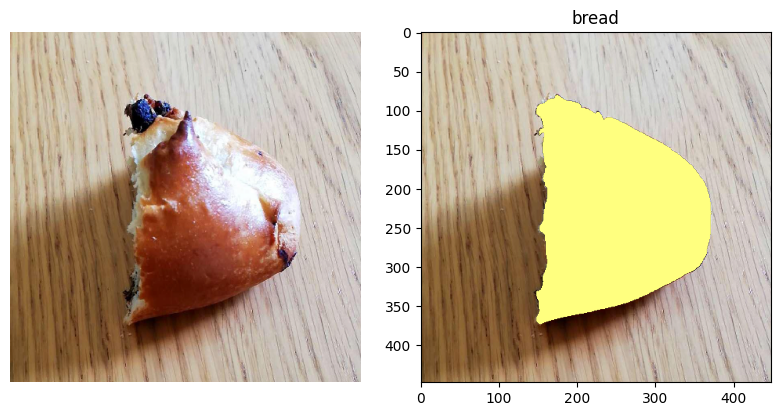

In [17]:
test(11)